# Model for joint multispecies distributions
Using real data. For more infromation on how these data were obtain go to: http://panthera:8888/notebooks/external_plugins/paper3code/%5BD.E%5DCell%20Extractor.ipynb 
<img src="sketch_model_DASE.png" width="400" height="400">

## Load libraries

In [1]:
import pandas as pd
import numpy as np

import pystan
import statsmodels.api as stmod
import scipy as sp


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
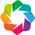

In [2]:
%matplotlib inline
import sys
sys.path.append('/apps')
import django
django.setup()
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd
## Use the ggplot style
plt.style.use('ggplot')
## Now, let's use pystan
import geopandas as gpd
import pystan
import patsy 
import utilities.data_extraction as de
## Use the ggplot style
plt.style.use('ggplot')
import geoviews as gv
import geoviews.feature as gf
from cartopy import crs
gv.extension('bokeh','matplotlib')
plt.rcParams['figure.figsize'] = [10, 10]


## Data Needed

In [6]:
ls ../../data/case-study2

casestudy2_grid128_fullstack_env_anth.gpkg  lattice128.pkl


In [7]:
## Geometry file

#datafile = '/data/output/casestudy2_grid128_fullstack_env_anth.gpkg'
datafile = '../../data/case-study2/casestudy2_grid128_fullstack_env_anth.gpkg'

## Readfile
data = gpd.read_file(datafile,na_values=np.nan)
data = data.replace('N.A.', np.nan)
data.set_index(['id','level'],inplace=True)
#gg.plot(edgecolor='black')
data.sort_index(level=1,inplace=True,sort_remaining=True)
NAN_VALUE_MODEL = 2
data.Y.replace(np.nan,NAN_VALUE_MODEL,inplace=True)
data.rename(columns={'Dist.to.road_m':'distance_to_road'},inplace=True)

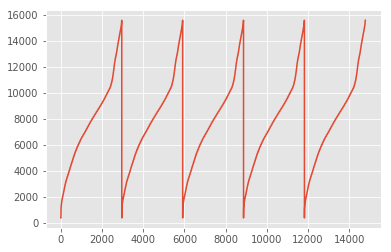

In [8]:
plt.plot(data.index.get_level_values(0))

In [9]:
data

,,Y,taxon,Elevation_m,MeanTemp_m,Precipitation_m,SolarRadiation_m,Longitude,Latitude,Population_m,distance_to_road,geometry
id,level,,,,,,,,,,,
368,1,0.0,Disocactus,-1638.154167,18.322460,9.677778,18494.076984,-118.335938,28.875,1.158417,NaN,"POLYGON ((-118.46875 28.75, -118.203125 28.75,..."
369,1,0.0,Disocactus,-632.137500,17.389565,12.846377,18552.396377,-118.335938,29.125,1.107086,NaN,"POLYGON ((-118.46875 29, -118.203125 29, -118...."
1021,1,0.0,Disocactus,-254.029167,16.595833,21.985043,18075.597222,-117.007812,32.125,65.587155,889.976144,"POLYGON ((-117.140625 32, -116.875 32, -116.87..."
1022,1,0.0,Disocactus,160.266667,17.280824,24.581583,18154.211601,-117.007812,32.375,1029.079257,3515.856005,"POLYGON ((-117.140625 32.25, -116.875 32.25, -..."
1023,1,0.0,Disocactus,132.900000,17.855101,24.104762,18043.944689,-117.007812,32.625,4284.286623,2836.496644,"POLYGON ((-117.140625 32.5, -116.875 32.5, -11..."
1146,1,0.0,Disocactus,-454.244444,NaN,NaN,NaN,-116.742188,31.375,0.189593,NaN,"POLYGON ((-116.875 31.25, -116.609375 31.25, -..."
1147,1,0.0,Disocactus,-198.417778,16.056716,22.488806,18343.175788,-116.742188,31.625,12.094556,2774.931319,"POLYGON ((-116.875 31.5, -116.609375 31.5, -11..."
1148,1,0.0,Disocactus,0.742222,16.704318,23.829758,18387.346810,-116.742188,31.875,377.729529,998.763594,"POLYGON ((-116.875 31.75, -116.609375 31.75, -..."
1149,1,0.0,Disocactus,349.728889,17.031752,25.102624,18454.530327,-116.742188,32.125,8.584742,2726.341331,"POLYGON ((-116.875 32, -116.609375 32, -116.60..."


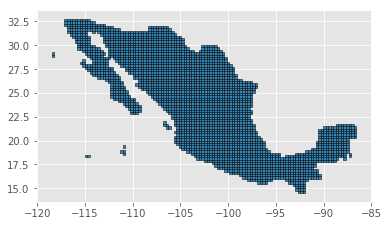

In [10]:
data.xs(1,level=1).plot(edgecolor='black')

In [13]:
import pickle
import networkx as nt

In [15]:
data_graph = '../../data/case-study2/lattice128.pkl-p2'
with open(data_graph, "rb") as input_file:
    lattice_128 = pickle.load(input_file)

In [21]:
islands_ids = list(nt.algorithms.components.connected_components(lattice_128))
subgraphs = list(map(lambda idxs : lattice_128.subgraph(idxs),islands_ids))
## Don't forget to order the cell ids 
subdfs = list(map(lambda island_ids :  data.loc[list(island_ids)].sort_index(level=0),islands_ids ))

In [22]:
# Generate adjacency matrices order by the node id
sub_adjmats = list(map(lambda s : nt.adjacency_matrix(s,nodelist=sorted(s.nodes())),subgraphs))
duple_df_mat = list(zip(subdfs,sub_adjmats))

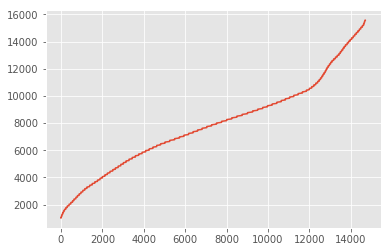

In [24]:
plt.plot(duple_df_mat[0][0].index.get_level_values(0))

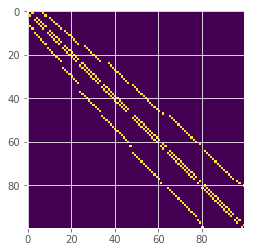

In [26]:
# Order cells by size, first the biggest, the one of interest in our case, Mexico
#sub_adjmats.sort(key=lambda m : m.shape[0],reverse=True)
plt.imshow(duple_df_mat[0][1].todense()[:100,:100])

In [32]:
# Select an "island" to fit model and so on.
# Let's start easy...

data_d, M = duple_df_mat[0]


In [33]:
means = data_d.mean()
for column in ['Elevation_m', 'MeanTemp_m', 'Precipitation_m','SolarRadiation_m','Population_m','distance_to_road']:
    data_d[column].replace(np.nan,means[column],inplace=True)

In [34]:
## Add an intercept to each process.
#### This is a work around and should be avoided in production.
formula = '~ Elevation_m + Precipitation_m + MeanTemp_m + distance_to_road + Population_m'
X1 = patsy.dmatrix(formula,data=data_d,return_type='dataframe',NA_action="drop")
X2 = patsy.dmatrix(formula,data=data_d,return_type='dataframe',NA_action="drop")
X1.drop(['distance_to_road','Population_m'],axis=1,inplace=True)
X2.drop(['Elevation_m','Precipitation_m','MeanTemp_m'],axis=1,inplace=True)
X = pd.concat([X1,X2],axis=1)

# Fitting the model

In [30]:
from external_plugins.paper3code import models

In [31]:
## Load model and compile 
multispecies_model = models.multispeciesCARModel_stationaryBernoulliMissingData()
%time multispecies_model = pystan.StanModel(model_code=multispecies_model)

INFO:pystan:COMPILING THE C++ CODE FOR MODEL anon_model_6a141f619f17bfb4c994ef7f73045e99 NOW.


CPU times: user 1.55 s, sys: 64 ms, total: 1.62 s
Wall time: 49.1 s


In [35]:
levels = data_d.index.get_level_values(1)
MaxLevels = 5
NM = M.todense()
## seems that N_edges is defined differently here.
N_edges = int(np.sum(NM)/2.0)
n_miss = data_d.groupby('Y').count().loc[2.0][0]

N = X.shape[0]
K = X.shape[1] 
J = MaxLevels
adjacency_matrix = NM  # Removed islands from M
## number of levels to model

## It needs here a precheck of the dimmensions of the covariates
n_eco_covs = 4
n_samp_covs = 3
n_areas = int(X.shape[0]/J)
y = data_d.Y.values.astype('int')

data_multilevel_CAR = {'N' : N,
        'N_ecological_covariates' : n_eco_covs,
        'N_sample_covariates' : n_samp_covs,
        'J': J,                  
        'N_edges' : N_edges,
        'N_areas' : n_areas,   
        'level': levels, # Stan counts starting at 1
        'W' : adjacency_matrix,            
        #'y': simulation['logit_p_sim'].values,
        #'y': simulation['q'].values,
        'y': y,              
        #'y': yy.simulated.values.flatten().astype('float'),
        'x': X,
        'N_miss' : n_miss,
        'Y_miss_array':np.array([1])
       }


### Reload the module just to check if the updated version was alright


In [ ]:

%time fit3 = multispecies_model.sampling(data=data_multilevel_CAR, iter=7000,chains=4, control={'adapt_delta':0.81}) #,'max_treedepth':15})
tuto = fit3.extract(permuted=True)
tuto.keys()

In [146]:
print(fit3.stansummary(pars='beta'))
print(fit3.stansummary(pars='alpha'))
print(fit3.stansummary(pars='alpha_car'))
print(fit3.stansummary(pars='tau'))

Inference for Stan model: anon_model_5f11d8bdb889deba9ae3be233ea8ddbe.
4 chains, each with iter=3000; warmup=1500; thin=1; 
post-warmup draws per chain=1500, total post-warmup draws=6000.

             mean se_mean     sd    2.5%     25%     50%     75%   97.5%  n_eff   Rhat
beta[1,1]   -9.06     0.1   2.57  -15.39  -10.47   -8.64   -7.23   -5.23  725.0    1.0
beta[2,1]  -10.13    0.09    2.6  -16.42  -11.53   -9.67   -8.26   -6.39  900.0   1.01
beta[3,1]  -30.35    0.74  10.96  -57.26  -35.51  -28.07   -22.6  -15.59  218.0   1.02
beta[4,1]  -11.84    0.07   2.45  -17.67  -13.14  -11.46  -10.15   -8.16 1176.0    1.0
beta[5,1]   -18.0     0.1   3.42  -26.15   -19.8  -17.48  -15.61  -12.82 1172.0    1.0
beta[6,1]     0.0     nan    0.0     0.0     0.0     0.0     0.0     0.0    nan    nan
beta[1,2] -1.7e-3  1.4e-5 5.0e-4 -2.9e-3 -1.9e-3 -1.6e-3 -1.3e-3 -9.3e-4 1185.0    1.0
beta[2,2] -8.0e-4  6.7e-6 2.7e-4 -1.4e-3 -9.6e-4 -7.7e-4 -6.1e-4 -3.6e-4 1675.0    1.0
beta[3,2]  4.9e-4  1.5e-5 4.

## Saving the model and traces

In [ ]:
import pickle
_file = "/outputs/presence_only_models/multispecies_model.pkl"
with open(_file, "rb") as f:
    data_list = pickle.load(f)
fit3 = data_dict['fit']
# fit = data_list[1]

## Continue sampling after burnin

In [60]:
## Continue after burnin
    # reuse tuned parameters
stepsize = fit3.get_stepsize()
# by default .get_inv_metric returns a list
inv_metric = fit3.get_inv_metric(as_dict=True)
init = fit3.get_last_position()
# increment seed by 1
#seed2 = seed + 1
control = {"stepsize" : stepsize,
            "inv_metric" : inv_metric,
            "adapt_engaged" : False
            }


In [61]:
%time fit_continue = multispecies_model.sampling(data=data_multilevel_CAR,iter=100,chains=4,control=control,init=init)#seed=seed,) #,'max_treedepth':15})


To run all diagnostics call pystan.check_hmc_diagnostics(fit)


CPU times: user 1min, sys: 3.14 s, total: 1min 3s
Wall time: 39min 35s


## Visualisation

In [19]:
data_dd= data.drop(['Latitude', 'Longitude'],axis=1)

In [20]:
#Extract P and S
results = fit3.extract(pars=['P','S','G','Q'])
#results = fit_continue.extract(pars=['P','S','G','Q'])

In [42]:
import scipy.special as sp
from holoviews import opts


In [116]:
P = results['P']
S = results['S']
G = results['G']
Q = results['Q']
P = pd.DataFrame(P.T)
Q = pd.DataFrame(Q.T)
G = pd.DataFrame(G.T)
S = pd.DataFrame(S.T)
quant = 0.5
#P_median = sp.expit(P.quantile(q=quant,axis=1))
#Q_median = sp.expit(Q.quantile(q=quant,axis=1))
#G_median = G.quantile(q=quant,axis=1)
#S_median = sp.expit(S.quantile(q=quant,axis=1))
#P_median = P.mean(axis=1)

P_median = P.quantile(q=0.5,axis=1)
Q_median = Q.quantile(q=0.5,axis=1)
G_median = G.quantile(q=0.5,axis=1)
S_median = S.quantile(q=0.5,axis=1)


In [140]:
x = np.linspace(-15,15,100)

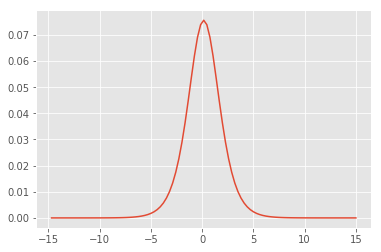

In [141]:
plt.plot(x[1:],np.diff(sp.expit(x)))

In [117]:
medians_levels = pd.concat([P_median,Q_median],axis=1)
medians_s = pd.concat([G_median,S_median],axis=1)

medians_levels.index = data.index
medians_levels.columns = ['Pm','Qm']
medians_s.index = data.xs(1,level=1).index
medians_s.columns = ['Gm','Sm']

new_l = gpd.GeoDataFrame(pd.concat([medians_levels,data_dd],axis=1))
new_s = gpd.GeoDataFrame(pd.concat([medians_s,data_dd.xs(1,level=1)],axis=1))

%time taxa_df = map(lambda i : data.xs(i,level=1)[data.Y.xs(i,level=1) > 0],range(1,7) )
%time taxa_results = map(lambda i : new_l.xs(i,level=1),range(1,7)) 

tnames = list(data_dd['taxon'].xs(238478))

CPU times: user 28 ms, sys: 0 ns, total: 28 ms
Wall time: 26 ms
CPU times: user 12 ms, sys: 0 ns, total: 12 ms
Wall time: 12.4 ms


In [106]:


i = 0
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)
cmap = plt.cm.viridis
#cmap = plt.cm.seismic


P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")



latent_pres_fig = ((P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

#clim = (-4,4)
#clim = (0,1)
latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        #clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)




:Layout
   .Leucaena.Ecological_Suitability_for                              :Overlay
      .Leucaena.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Leucaena.Sample                                                        :Points   [x,y]
      .Leucaena.Presence                                                      :Points   [x,y]
   .Leucaena.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Leucaena.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Leucaena.Sample                                               :Points   [x,y]
      .Leucaena.Presence                                             :Points   [x,y]

In [112]:
i = 1
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)
cmap = plt.cm.viridis



P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")



latent_pres_fig = ((P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

#clim = (-4,4)

latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        #clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)


:Layout
   .Phyllostomidae.Ecological_Suitability_for                              :Overlay
      .Phyllostomidae.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Phyllostomidae.Sample                                                        :Points   [x,y]
      .Phyllostomidae.Presence                                                      :Points   [x,y]
   .Phyllostomidae.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Phyllostomidae.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Phyllostomidae.Sample                                               :Points   [x,y]
      .Phyllostomidae.Presence                                             :Points   [x,y]

In [113]:
i = 2
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)
cmap = plt.cm.viridis



P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")



latent_pres_fig = ((P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

#clim = (-4,4)

latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        #clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)


:Layout
   .Picidae.Ecological_Suitability_for                              :Overlay
      .Picidae.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Picidae.Sample                                                        :Points   [x,y]
      .Picidae.Presence                                                      :Points   [x,y]
   .Picidae.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Picidae.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Picidae.Sample                                               :Points   [x,y]
      .Picidae.Presence                                             :Points   [x,y]

In [114]:
i = 3
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)
cmap = plt.cm.viridis



P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")



latent_pres_fig = ((P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

#clim = (-4,4)

latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        #clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)


:Layout
   .Quercus.Ecological_Suitability_for                              :Overlay
      .Quercus.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Quercus.Sample                                                        :Points   [x,y]
      .Quercus.Presence                                                      :Points   [x,y]
   .Quercus.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Quercus.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Quercus.Sample                                               :Points   [x,y]
      .Quercus.Presence                                             :Points   [x,y]

In [115]:
i = 4
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)
cmap = plt.cm.viridis
#cmap = plt.cm.RdBu
#cmap = plt.cm.Blues

P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")



latent_pres_fig = ((P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

#clim = (-4,4)
clim = (0,1)

latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        #clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)


:Layout
   .Pinaceae.Ecological_Suitability_for                              :Overlay
      .Pinaceae.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Pinaceae.Sample                                                        :Points   [x,y]
      .Pinaceae.Presence                                                      :Points   [x,y]
   .Pinaceae.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Pinaceae.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Pinaceae.Sample                                               :Points   [x,y]
      .Pinaceae.Presence                                             :Points   [x,y]

In [111]:
i = 5
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)

cmap = plt.cm.viridis
#cmap = plt.cm.RdBu


P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")



latent_pres_fig = ((P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

clim = (0,1)

latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)


:Layout
   .Complement.Ecological_Suitability_for                              :Overlay
      .Complement.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Complement.Sample                                                        :Points   [x,y]
      .Complement.Presence                                                      :Points   [x,y]
   .Complement.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Complement.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Complement.Sample                                               :Points   [x,y]
      .Complement.Presence                                             :Points   [x,y]

## With logarithm


In [30]:
i = 0
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)
cmap = plt.cm.viridis



P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")



latent_pres_fig = ((P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

#clim = (-4,4)

latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        #clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)


:Layout
   .Leucaena.Ecological_Suitability_for                              :Overlay
      .Leucaena.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Leucaena.Sample                                                        :Points   [x,y]
      .Leucaena.Presence                                                      :Points   [x,y]
   .Leucaena.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Leucaena.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Leucaena.Sample                                               :Points   [x,y]
      .Leucaena.Presence                                             :Points   [x,y]

In [31]:
i = 1
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)
cmap = plt.cm.viridis



P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")



latent_pres_fig = ((P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

#clim = (-4,4)

latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        #clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)


:Layout
   .Phyllostomidae.Ecological_Suitability_for                              :Overlay
      .Phyllostomidae.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Phyllostomidae.Sample                                                        :Points   [x,y]
      .Phyllostomidae.Presence                                                      :Points   [x,y]
   .Phyllostomidae.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Phyllostomidae.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Phyllostomidae.Sample                                               :Points   [x,y]
      .Phyllostomidae.Presence                                             :Points   [x,y]

In [32]:
i = 2
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)
cmap = plt.cm.viridis



P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")



latent_pres_fig = ((P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

#clim = (-4,4)

latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        #clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)


:Layout
   .Picidae.Ecological_Suitability_for                              :Overlay
      .Picidae.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Picidae.Sample                                                        :Points   [x,y]
      .Picidae.Presence                                                      :Points   [x,y]
   .Picidae.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Picidae.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Picidae.Sample                                               :Points   [x,y]
      .Picidae.Presence                                             :Points   [x,y]

In [33]:
i = 3
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)
cmap = plt.cm.viridis



P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")



latent_pres_fig = ((P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

#clim = (-4,4)

latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        #clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)


:Layout
   .Quercus.Ecological_Suitability_for                              :Overlay
      .Quercus.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Quercus.Sample                                                        :Points   [x,y]
      .Quercus.Presence                                                      :Points   [x,y]
   .Quercus.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Quercus.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Quercus.Sample                                               :Points   [x,y]
      .Quercus.Presence                                             :Points   [x,y]

In [145]:
i = 4
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)
cmap = plt.cm.viridis



P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")


g = gv.tile_sources.EsriImagery()
latent_pres_fig = (( P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

#clim = (-4,4)

latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        #clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)


:Layout
   .Pinaceae.Ecological_Suitability_for                              :Overlay
      .Pinaceae.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Pinaceae.Sample                                                        :Points   [x,y]
      .Pinaceae.Presence                                                      :Points   [x,y]
   .Pinaceae.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Pinaceae.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Pinaceae.Sample                                               :Points   [x,y]
      .Pinaceae.Presence                                             :Points   [x,y]

In [35]:
i = 5
group_name = tnames[i]
label_p = "Ecological Suitability for "
label_q = "Mixed latent Q(x) for "

complement_df = taxa_df[5]
presences_df = taxa_df[i]
#pines_pt = gTDF[gTDF.Abies > 0]
#complement_pt = taxa_df[1]


#### Change accordingly

width = 600
height = 650

sample_pt = gv.Points((complement_df.Longitude,complement_df.Latitude),group=group_name,label='Sample').opts(
            fill_color = 'red',
            line_color = 'grey',
            line_width = 0.2,
            line_alpha = 0.9,
            fill_alpha = 0.6,
            size = 2,
            )

presence_pt = gv.Points((presences_df.Longitude,presences_df.Latitude),group=group_name,label='Presence').opts(
           marker = 'x',
          color = 'black')

obs = (sample_pt * presence_pt)
cmap = plt.cm.viridis



P = gv.Polygons(taxa_results[i],vdims=['Pm','Qm'],group=group_name,label="Ecological Suitability P(x)")
Q = gv.Polygons(taxa_results[i],vdims=['Qm','Pm'],group=group_name,label="Mixing effect Q(x)")



latent_pres_fig = ((P * obs).relabel(label_p) + (Q * obs).relabel(label_q))
#latent_pres_fig = ((P).relabel(lm) + (Q ).relabel(lm))

#clim = (-4,4)

latent_pres_fig.opts(
    opts.Polygons(
        line_width=0.001,
        line_alpha = 0.2,
        tools=['hover'],
        width = width,
        height = height,
        colorbar = True,
        #clim = clim,        
        colorbar_position = 'bottom',
        alpha = 1.0,
        cmap = cmap,),
    #merge_tools=False
)


:Layout
   .Complement.Ecological_Suitability_for                              :Overlay
      .Complement.Ecological_Suitability_P_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Pm,Qm)
      .Complement.Sample                                                        :Points   [x,y]
      .Complement.Presence                                                      :Points   [x,y]
   .Complement.Mixed_latent_Q_left_parenthesis_x_right_parenthesis_for :Overlay
      .Complement.Mixing_effect_Q_left_parenthesis_x_right_parenthesis :Polygons   [Longitude,Latitude]   (Qm,Pm)
      .Complement.Sample                                               :Points   [x,y]
      .Complement.Presence                                             :Points   [x,y]

In [ ]:
gv.tile_sources.EsriImagery

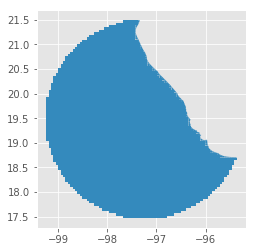

In [101]:
new.xs(1,level=1)

## Test to unpickle an object


In [88]:
import pickle
with open("/mnt/data1/outputs/from_hec/multispecies_m.pkl", "rb") as f:
    data_dict = pickle.load(f)
    # or with a list
    # data_list = pickle.load(f)
fit = data_dict['fit']
# fit = data_list[1]

/opt/conda/envs/biospytial/lib/python2.7/site-packages/pandas/core/indexes/base.py:162: FutureWarning: the 'labels' keyword is deprecated, use 'codes' instead
  return cls.__new__(cls, **d)


In [90]:
print(fit.stansummary(pars='beta'))
print(fit.stansummary(pars='alpha'))
print(fit.stansummary(pars='alpha_car'))
print(fit.stansummary(pars='tau'))

Inference for Stan model: anon_model_c886f98cb6e47ecc6d69746055875c04.
5 chains, each with iter=10; warmup=5; thin=1; 
post-warmup draws per chain=5, total post-warmup draws=25.

            mean se_mean     sd   2.5%    25%    50%    75%  97.5%  n_eff   Rhat
beta[1,1]   0.22     nan   1.26   -1.0  -0.78  -0.55   1.61   1.83    nan    inf
beta[2,1]   0.58     nan    1.1  -0.84  -0.11   0.17   1.68   1.98    nan    inf
beta[3,1]   0.59     nan    1.2  -1.18  -0.38   1.11   1.52   1.88    nan    inf
beta[4,1]   0.14     nan   0.85  -0.54  -0.49   -0.2   0.23   1.71    nan    inf
beta[5,1]  -0.91     nan   1.06  -1.92   -1.9  -1.16  -0.44   0.86    nan    inf
beta[6,1]   0.88     nan    1.1  -0.93   0.48   0.93   1.95   1.99    nan    inf
beta[1,2]  -0.63     nan   0.93  -1.73  -1.47  -0.72   0.03   0.73    nan    inf
beta[2,2]  -0.26     nan   1.19  -1.61  -1.21  -0.67   0.82   1.38    nan    inf
beta[3,2]   0.24     nan    1.0  -1.19  -0.02   0.01   0.57   1.84    nan    inf
beta[4,2]  

# Methods


## Build the matrix given parameters $\alpha$, $\tau$ and data $M$ and $D$

## Merging datasets from different covariates in a multilevel design matrix

It seems that in order to join covariates from different sources it is not enough to expand the covariate space
in K+L where K is the number of covariates for the presences and L the number of covariates for the sample process.
We need to give heterogeneity in the domain in order for the response variable to have information. All predictors in
zero mean that N observations (marginal to those covariates) have only one predictor value. What we really are looking for 
is for a constant no matter how much variability the domain (space of predictors) has.

The suggestion is to populate the the covariates with uniform random numbers ranging from the minimum to the maximum of 
the other columns. As the uniform distribution is ergodic it will occupy all the parametric space within that range and
the beta coefficients will be zero.

This is interesting to explore further. For the moment, with the simulated dataset it doesn't matter. The noise is random 
normal standard and the beta coefficients associated with those "null" columns is zero. 

For achiving this use `composeMultiSpeciesSyntheticDataSetModel1`

> Todo: Add the random noise in `composeMultiSpeciesDataSetModel2` 
